---
# Quality control

In [1]:
from linescanning import (
    utils,
    plotting,
    fitting,
)
import nibabel as nb
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import holeresponse as hr
opj = os.path.join
opd = os.path.dirname

In [32]:
# import subject dictionary containing useful information
subj_obj = hr.utils.SubjectsDict(proj_dir="/data1/projects/MicroFunc/Jurjen/projects/VE-NORDIC")
subj_obj.proj_dir

'/data1/projects/MicroFunc/Jurjen/projects/VE-NORDIC'

In [3]:
# get h5-file
deriv = opj(subj_obj.proj_dir, "derivatives")
repo_dir = "/data1/projects/MicroFunc/Jurjen/programs/project_repos/holeresponse"

subj_list = subj_obj.get_subjects()
excl = [
    # "sub-001",
    # "sub-003"
]

h5_files = []
incl_subjs = []
for i in subj_list:
    if not i in excl:
        ses = subj_obj.get_session(i)
        h5 = utils.FindFiles(opj(deriv, "lsprep", i), extension="h5").files

        if len(h5)>0:
            h5_filt = utils.get_file_from_substring([f"ses-{ses}","desc-0p"], h5)
            h5_files.append(h5_filt)

        incl_subjs.append(i)
h5_files

['/data1/projects/MicroFunc/Jurjen/projects/VE-NORDIC/derivatives/lsprep/sub-001/sub-001_ses-4_desc-0p_bold.h5',
 '/data1/projects/MicroFunc/Jurjen/projects/VE-NORDIC/derivatives/lsprep/sub-002/sub-002_ses-3_desc-0p_bold.h5',
 '/data1/projects/MicroFunc/Jurjen/projects/VE-NORDIC/derivatives/lsprep/sub-003/sub-003_ses-7_desc-0p_bold.h5',
 '/data1/projects/MicroFunc/Jurjen/projects/VE-NORDIC/derivatives/lsprep/sub-005/sub-005_ses-2_desc-0p_bold.h5',
 '/data1/projects/MicroFunc/Jurjen/projects/VE-NORDIC/derivatives/lsprep/sub-006/sub-006_ses-3_desc-0p_bold.h5',
 '/data1/projects/MicroFunc/Jurjen/projects/VE-NORDIC/derivatives/lsprep/sub-008/sub-008_ses-3_desc-0p_bold.h5',
 '/data1/projects/MicroFunc/Jurjen/projects/VE-NORDIC/derivatives/lsprep/sub-010/sub-010_ses-4_desc-0p_bold.h5',
 '/data1/projects/MicroFunc/Jurjen/projects/VE-NORDIC/derivatives/lsprep/sub-011/sub-011_ses-2_desc-0p_bold.h5',
 '/data1/projects/MicroFunc/Jurjen/projects/VE-NORDIC/derivatives/lsprep/sub-013/sub-013_ses-2_d

In [4]:
incl_subjs

['sub-001',
 'sub-002',
 'sub-003',
 'sub-005',
 'sub-006',
 'sub-008',
 'sub-010',
 'sub-011',
 'sub-013',
 'sub-014',
 'sub-015',
 'sub-016',
 'sub-017',
 'sub-018',
 'sub-019',
 'sub-020',
 'sub-022']

In [5]:
len(incl_subjs)

17

## Read data

In [6]:
# dd = hr.data.H5Parser(
#     h5_files[:2],
#     verbose=True,
#     compartments=20,
#     lp_kw={
#         "window_length": 31
#     },
#     lp=True,
#     n_jobs=1,
#     unique_ribbon=True
# )

In [6]:
# parse h5-files
import pickle
data_dir = opj(os.path.dirname(hr.viz._save_figure(None, return_figdir=True)), "data")

n_compartiments = 20
pkl_base = "dn_full_sample"
h5_pkl = opj(data_dir, f"{pkl_base}.pkl")
overwrite = False
save = True

if not os.path.exists(h5_pkl) or overwrite:
    h5_obj = hr.data.H5Parser(
        h5_files,
        compartments=n_compartiments,
        lp_kw={
            "window_length": 31
        },
        lp=True,
        unique_ribbon=True
    )

    if save:
        print(f"Writing object to '{h5_pkl}'")
        with open(h5_pkl, 'wb') as handle:
            pickle.dump(h5_obj, handle, protocol=pickle.HIGHEST_PROTOCOL)
else:
    print(f"Reading from '{h5_pkl}'")
    with open(h5_pkl, 'rb') as handle:
        h5_obj = pickle.load(handle)

Reading from '/data1/projects/MicroFunc/Jurjen/programs/project_repos/holeresponse/data/dn_full_sample.pkl'


## Read models



### Uncorrected

In [35]:
glm_pkl = opj(opd(h5_pkl), "dn_glms.pkl")
print(f"Reading from '{glm_pkl}'")
with open(glm_pkl, 'rb') as handle:
    sub_glms = pickle.load(handle)

sub_glms

Reading from '/data1/projects/MicroFunc/Jurjen/programs/project_repos/holeresponse/data/dn_glms.pkl'


{'sub-001': <linescanning.glm.GenericGLM at 0x7f027a52efd0>,
 'sub-002': <linescanning.glm.GenericGLM at 0x7f027aa4bc70>,
 'sub-003': <linescanning.glm.GenericGLM at 0x7f027b016160>,
 'sub-005': <linescanning.glm.GenericGLM at 0x7f027ab28130>,
 'sub-006': <linescanning.glm.GenericGLM at 0x7f027b1a6c40>,
 'sub-008': <linescanning.glm.GenericGLM at 0x7f0278d3b4c0>,
 'sub-010': <linescanning.glm.GenericGLM at 0x7f0278d4a2b0>,
 'sub-011': <linescanning.glm.GenericGLM at 0x7f0278d44bb0>,
 'sub-013': <linescanning.glm.GenericGLM at 0x7f027cc4d7f0>,
 'sub-014': <linescanning.glm.GenericGLM at 0x7f0278d42c40>,
 'sub-015': <linescanning.glm.GenericGLM at 0x7f027ab973d0>,
 'sub-016': <linescanning.glm.GenericGLM at 0x7f027ab97e80>,
 'sub-017': <linescanning.glm.GenericGLM at 0x7f027ab68970>,
 'sub-018': <linescanning.glm.GenericGLM at 0x7f027c22e460>,
 'sub-019': <linescanning.glm.GenericGLM at 0x7f027c22ef10>,
 'sub-020': <linescanning.glm.GenericGLM at 0x7f027c217a00>,
 'sub-022': <linescannin

sub-001; CSF [358] to max r2 [365] = -7 voxels	r2 max within ribbon
sub-002; CSF [358] to max r2 [350] = 8 voxels	r2 max not within ribbon
sub-003; CSF [357] to max r2 [358] = -1 voxels	r2 max within ribbon
sub-005; CSF [357] to max r2 [366] = -9 voxels	r2 max within ribbon
sub-006; CSF [360] to max r2 [364] = -4 voxels	r2 max within ribbon
sub-008; CSF [357] to max r2 [358] = -1 voxels	r2 max within ribbon
sub-010; CSF [365] to max r2 [333] = 32 voxels	r2 max not within ribbon
sub-011; CSF [368] to max r2 [367] = 1 voxels	r2 max within ribbon
sub-013; CSF [363] to max r2 [365] = -2 voxels	r2 max not within ribbon
sub-014; CSF [361] to max r2 [365] = -4 voxels	r2 max not within ribbon
sub-015; CSF [359] to max r2 [364] = -5 voxels	r2 max within ribbon
sub-016; CSF [361] to max r2 [370] = -9 voxels	r2 max not within ribbon
sub-017; CSF [359] to max r2 [362] = -3 voxels	r2 max not within ribbon
sub-018; CSF [366] to max r2 [366] = 0 voxels	r2 max within ribbon
sub-019; CSF [367] to max r

Text(0.5, 0.98, 'Uncorrected')

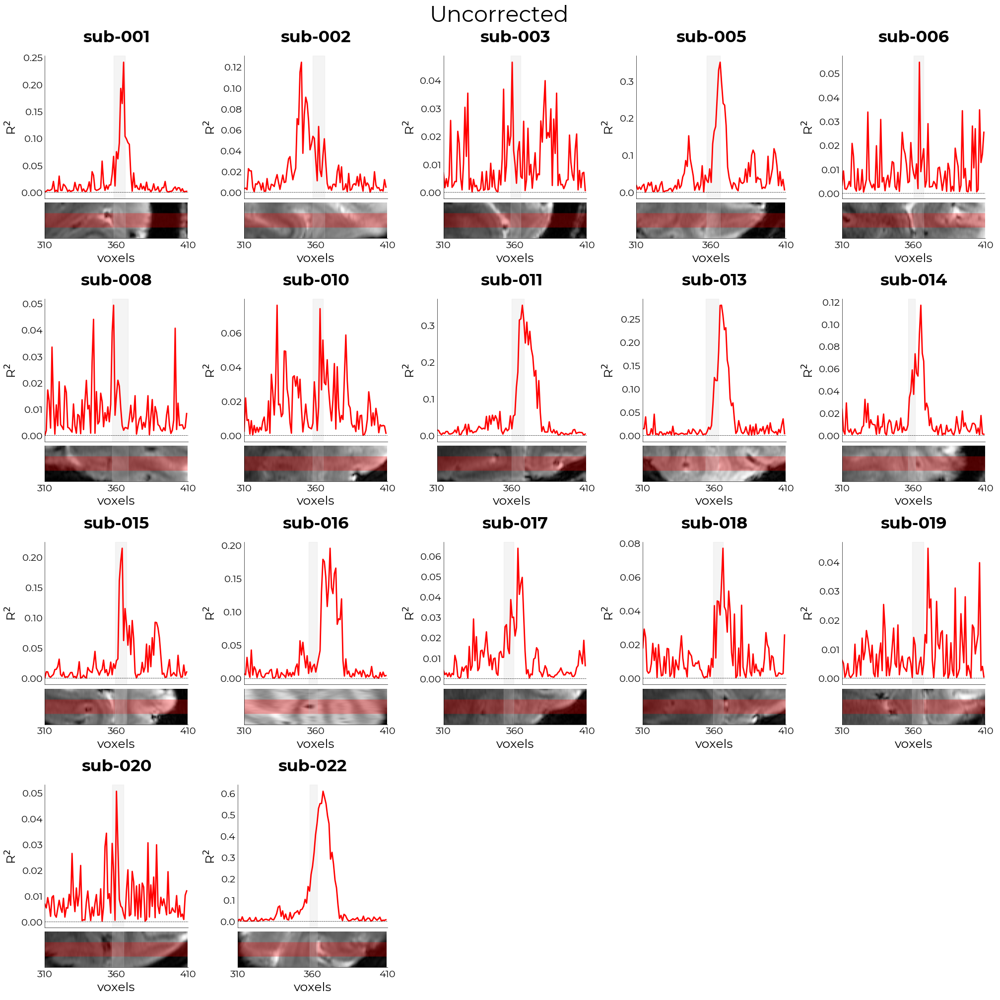

In [28]:
%matplotlib inline
subj_ids = subj_obj.get_subjects()
ncols = 5
nrows = int(np.ceil(len(subj_ids)/ncols))

fig = plt.figure(figsize=(ncols*4,nrows*5), constrained_layout=True)
sf = fig.subfigures(
    ncols=ncols, 
    nrows=nrows
)
r2s = []
x_lim = [310,410]
y_lim = [340,380]
for ix,ax in enumerate(sf.flatten()):

    if (ix+1)<=len(subj_ids):
        
        sub = subj_ids[ix]
        
        select_sub = sub_glms[sub]
        r2_vals = select_sub.results["r2"]
        r2_ref = np.zeros_like(r2_vals)
        r2_ref[x_lim[0]:x_lim[1]] = r2_vals[x_lim[0]:x_lim[1]]
        rib = subj_obj.get_ribbon(sub, from_unique=True)

        max_r2 = np.where(r2_ref == r2_ref.max())[0][0]        
        if subj_obj.get_invert(sub):
            idx = 1
        else:
            idx = 0

        csf_vox = rib[idx]
        dist_vox = csf_vox-max_r2

        if rib[0] <= max_r2 <= rib[1]:
            txt = "r2 max within ribbon"
        else:
            txt = "r2 max not within ribbon"

        print(f"{sub}; CSF [{csf_vox}] to max r2 [{max_r2}] = {dist_vox} voxels\t{txt}")

        imgs = {}
        ref_slc = subj_obj.get_slc(sub)
        ref_beam = subj_obj.get_beam(sub)
        for img,ff in zip(["slice","beam"],[ref_slc,ref_beam]):

            if isinstance(ff, str):
                imgs[img] = nb.load(ff).get_fdata().squeeze()
            else:
                raise TypeError(f"{ff} is of type {type(ff)}. Must be a string pointing to a path")
        # imgs
    
        axs = ax.subplots(
            nrows=2,
            sharex=True,
            height_ratios=[0.8,0.2],
            gridspec_kw={
                "hspace": -0.4
            }
        )

        r2s.append(r2_vals)

        pl = plotting.LazyPlot(
            r2_vals[x_lim[0]:x_lim[1]],
            axs=axs[0],
            y_label="R$^2$",
            # labels=list(select_sub.keys()),
            color="r",
            alpha=[0.3,0.8,1],
            line_width=2,
            add_hline=0,
            title={
                "title": sub,
                "fontweight": "bold"
            }
        )

        for cm,cr,key,alpha in zip(
            ["Greys_r","r"],
            [False,True],
            list(imgs.keys()),
            [None,0.3]
            ):
            
            if cr:
                cm = utils.make_binary_cm(cm)

            # rotate image to deal with Left-right saturation slabs
            if key == "slice":
                fo = subj_obj.get(sub, "foldover")
                if fo != "FH":
                    imgs[key] = np.rot90(imgs[key])

            cut_img = np.rot90(imgs[key])[y_lim[0]:y_lim[1],x_lim[0]:x_lim[1]]
            im = axs[1].imshow(
                cut_img,
                cmap=cm,
                alpha=alpha,
                aspect="auto"
            )

        plotting.conform_ax_to_obj(
            ax=axs[1],
            y_ticks=[],
            x_label="voxels",
            x_ticks=np.linspace(0,cut_img.shape[1],3, dtype=int),
            x_ticklabels=[x_lim[0],360,x_lim[-1]],
            force_int=True
        )

        for ax in axs:
            ax.axvspan(
                *[i-x_lim[0] for i in rib], 
                alpha=0.2, 
                color="#cccccc"
            )

fig.suptitle("Uncorrected", fontsize=32)
# hr.viz._save_figure(fig, fname="group_desc-epochs_subjects") #, overwrite=True)

### After correction

sub-001; CSF [365] to max r2 [365] = 0 voxels	r2 max within ribbon
sub-002; CSF [350] to max r2 [350] = 0 voxels	r2 max within ribbon
sub-003; CSF [358] to max r2 [358] = 0 voxels	r2 max within ribbon
sub-005; CSF [366] to max r2 [366] = 0 voxels	r2 max within ribbon
sub-006; CSF [364] to max r2 [364] = 0 voxels	r2 max within ribbon
sub-008; CSF [358] to max r2 [358] = 0 voxels	r2 max within ribbon
sub-010; CSF [363] to max r2 [333] = 30 voxels	r2 max not within ribbon
sub-011; CSF [367] to max r2 [367] = 0 voxels	r2 max within ribbon
sub-013; CSF [365] to max r2 [365] = 0 voxels	r2 max within ribbon
sub-014; CSF [361] to max r2 [365] = -4 voxels	r2 max not within ribbon
sub-015; CSF [364] to max r2 [364] = 0 voxels	r2 max within ribbon
sub-016; CSF [370] to max r2 [370] = 0 voxels	r2 max within ribbon
sub-017; CSF [362] to max r2 [362] = 0 voxels	r2 max within ribbon
sub-018; CSF [366] to max r2 [366] = 0 voxels	r2 max within ribbon
sub-019; CSF [370] to max r2 [370] = 0 voxels	r2 max

Text(0.5, 0.98, 'Corrected')

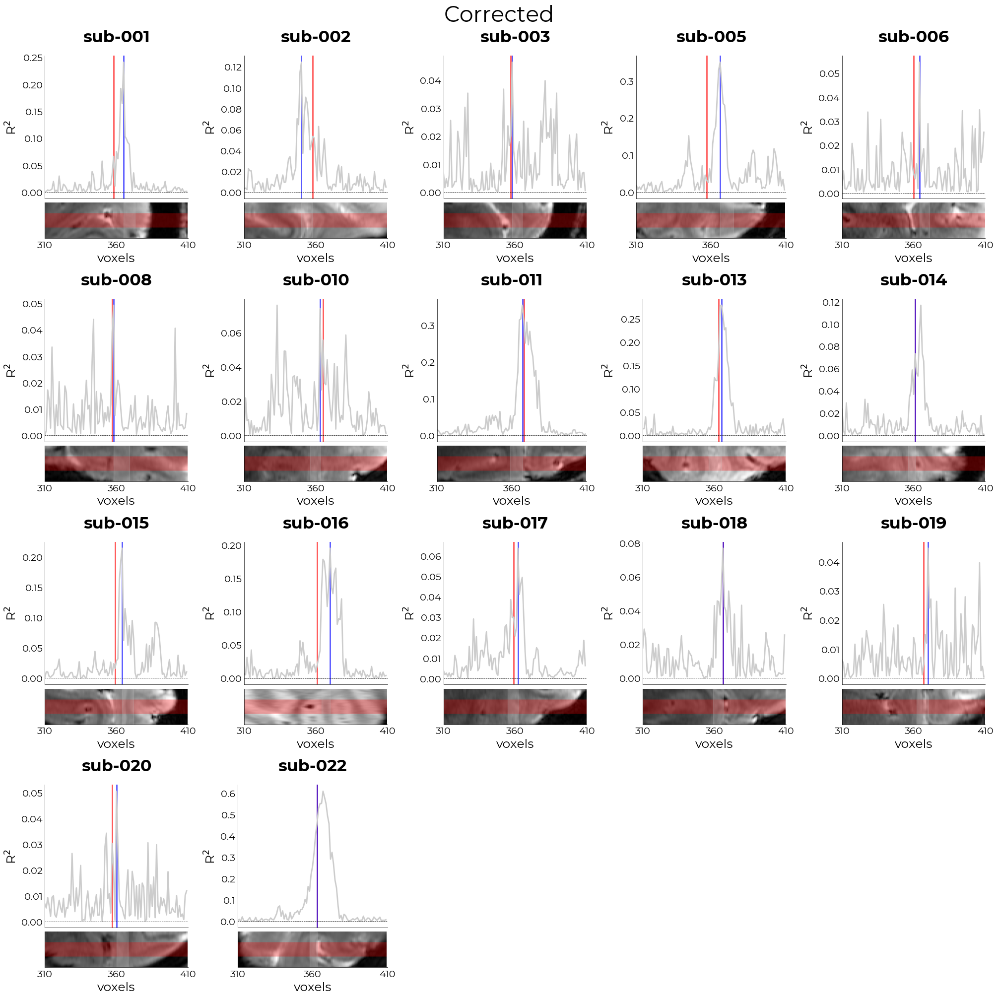

In [32]:
%matplotlib inline
subj_ids = subj_obj.get_subjects()
ncols = 5
nrows = int(np.ceil(len(subj_ids)/ncols))

fig = plt.figure(figsize=(ncols*4,nrows*5), constrained_layout=True)
sf = fig.subfigures(
    ncols=ncols, 
    nrows=nrows
)
r2s = []
x_lim = [310,410]
y_lim = [340,380]
for ix,ax in enumerate(sf.flatten()):

    if (ix+1)<=len(subj_ids):
        
        sub = subj_ids[ix]
        
        select_sub = sub_glms[sub]
        r2_vals = select_sub.results["r2"]
        r2_ref = np.zeros_like(r2_vals)
        r2_ref[x_lim[0]:x_lim[1]] = r2_vals[x_lim[0]:x_lim[1]]

        # correct ribbon voxels
        corr = subj_obj.get(sub, "ribbon_correction")
        old_rib = subj_obj.get_ribbon(sub, from_unique=True)
        rib = [i+corr for i in old_rib]

        max_r2 = np.where(r2_ref == r2_ref.max())[0][0]        
        if subj_obj.get_invert(sub):
            idx = 1
        else:
            idx = 0

        csf_vox = rib[idx]
        dist_vox = csf_vox-max_r2

        if rib[0] <= max_r2 <= rib[1]:
            txt = "r2 max within ribbon"
        else:
            txt = "r2 max not within ribbon"


        if rib[0] <= max_r2 <= rib[1]:
            txt = "r2 max within ribbon"
        else:
            txt = "r2 max not within ribbon"

        print(f"{sub}; CSF [{csf_vox}] to max r2 [{max_r2}] = {dist_vox} voxels\t{txt}")

        imgs = {}
        ref_slc = subj_obj.get_slc(sub)
        ref_beam = subj_obj.get_beam(sub)
        for img,ff in zip(["slice","beam"],[ref_slc,ref_beam]):

            if isinstance(ff, str):
                imgs[img] = nb.load(ff).get_fdata().squeeze()
            else:
                raise TypeError(f"{ff} is of type {type(ff)}. Must be a string pointing to a path")
        # imgs
    
        axs = ax.subplots(
            nrows=2,
            sharex=True,
            height_ratios=[0.8,0.2],
            gridspec_kw={
                "hspace": -0.4
            }
        )

        r2s.append(r2_vals)

        for r,c in zip([old_rib, rib],["r","b"]):
            axs[0].axvline(
                r[idx]-x_lim[0], 
                lw=2,
                color=c,
                alpha=0.65
            )

        pl = plotting.LazyPlot(
            r2_vals[x_lim[0]:x_lim[1]],
            axs=axs[0],
            y_label="R$^2$",
            # labels=list(select_sub.keys()),
            color="#cccccc",
            alpha=[0.3,0.8,1],
            line_width=2,
            add_hline=0,
            title={
                "title": sub,
                "fontweight": "bold"
            }
        )

        for cm,cr,key,alpha in zip(
            ["Greys_r","r"],
            [False,True],
            list(imgs.keys()),
            [None,0.3]
            ):
            
            if cr:
                cm = utils.make_binary_cm(cm)

            # rotate image to deal with Left-right saturation slabs
            if key == "slice":
                fo = subj_obj.get(sub, "foldover")
                if fo != "FH":
                    imgs[key] = np.rot90(imgs[key])

            cut_img = np.rot90(imgs[key])[y_lim[0]:y_lim[1],x_lim[0]:x_lim[1]]
            im = axs[1].imshow(
                cut_img,
                cmap=cm,
                alpha=alpha,
                aspect="auto"
            )

        plotting.conform_ax_to_obj(
            ax=axs[1],
            y_ticks=[],
            x_label="voxels",
            x_ticks=np.linspace(0,cut_img.shape[1],3, dtype=int),
            x_ticklabels=[x_lim[0],360,x_lim[-1]],
            force_int=True
        )

        axs[1].axvspan(
            *[i-x_lim[0] for i in rib], 
            alpha=0.2, 
            color="#cccccc"
        )

fig.suptitle("Corrected", fontsize=32)            
# hr.viz._save_figure(fig, fname="group_desc-epochs_subjects") #, overwrite=True)

## Epoch improvement?

### Create new pickle-file

In [7]:
# parse h5-files
import pickle
data_dir = opj(os.path.dirname(hr.viz._save_figure(None, return_figdir=True)), "data")

n_compartiments = 20
corr_base = "dn_full_sample_voxel_correction"
corr_pkl = opj(data_dir, f"{corr_base}.pkl")
overwrite = False
save = True

if not os.path.exists(corr_pkl) or overwrite:
    corr_obj = hr.data.H5Parser(
        h5_files,
        compartments=n_compartiments,
        lp_kw={
            "window_length": 31
        },
        lp=True,
        unique_ribbon=True,
        ribbon_correction=True
    )

    if save:
        print(f"Writing object to '{corr_pkl}'")
        with open(corr_pkl, 'wb') as handle:
            pickle.dump(corr_obj, handle, protocol=pickle.HIGHEST_PROTOCOL)
else:
    print(f"Reading from '{corr_pkl}'")
    with open(corr_pkl, 'rb') as handle:
        corr_obj = pickle.load(handle)

Reading from '/data1/projects/MicroFunc/Jurjen/programs/project_repos/holeresponse/data/dn_full_sample_voxel_correction.pkl'


### Epoch data

In [8]:
# corrected run-specific depth epochs
tmp = fitting.Epoch(
    corr_obj.df_comps,
    corr_obj.df_onsets,
    TR=0.105,
    interval=[-2,14]
)
run_comps_corr = tmp.df_epoch.copy()

# uncorrected run-specific depth epochs
tmp = fitting.Epoch(
    h5_obj.df_comps,
    h5_obj.df_onsets,
    TR=0.105,
    interval=[-2,14]
)
run_comps_uncorr = tmp.df_epoch.copy()

In [9]:
# corrected run-specific averaged across depth
run_ep = fitting.Epoch(
    corr_obj.df_avg_full,
    corr_obj.df_onsets_full,
    TR=0.105,
    interval=[-2,14]
)
run_corr = run_ep.df_epoch.copy()
run_corr

# uncorrected run-specific averaged across depth
run_ep = fitting.Epoch(
    h5_obj.df_avg_full,
    h5_obj.df_onsets_full,
    TR=0.105,
    interval=[-2,14]
)
run_uncorr = run_ep.df_epoch.copy()

In [10]:
# corrected averaged across runs and ribbon
sub_ep = fitting.Epoch(
    corr_obj.df_avg.groupby(["subject","task","t"]).mean(),
    hr.data.average_tasks(corr_obj.df_onsets),
    TR=0.105,
    interval=[-2,14]
)
sub_corr = sub_ep.df_epoch.copy()
sub_corr

# corrected averaged across runs and ribbon
sub_ep = fitting.Epoch(
    h5_obj.df_avg.groupby(["subject","task","t"]).mean(),
    hr.data.average_tasks(h5_obj.df_onsets),
    TR=0.105,
    interval=[-2,14]
)
sub_uncorr = sub_ep.df_epoch.copy()

### Run-specific epochs

#### uncorrected

plotting sub-001
plotting sub-002
plotting sub-003
plotting sub-005
plotting sub-006
plotting sub-008
plotting sub-010
plotting sub-011
plotting sub-013
plotting sub-014
plotting sub-015
plotting sub-016
plotting sub-017
plotting sub-018
plotting sub-019
plotting sub-020
plotting sub-022
Writing '/data1/projects/MicroFunc/Jurjen/programs/project_repos/holeresponse/images/run_epochs_uncorr.pdf'
Writing '/data1/projects/MicroFunc/Jurjen/programs/project_repos/holeresponse/images/run_epochs_uncorr.png'
Writing '/data1/projects/MicroFunc/Jurjen/programs/project_repos/holeresponse/images/run_epochs_uncorr.svg'


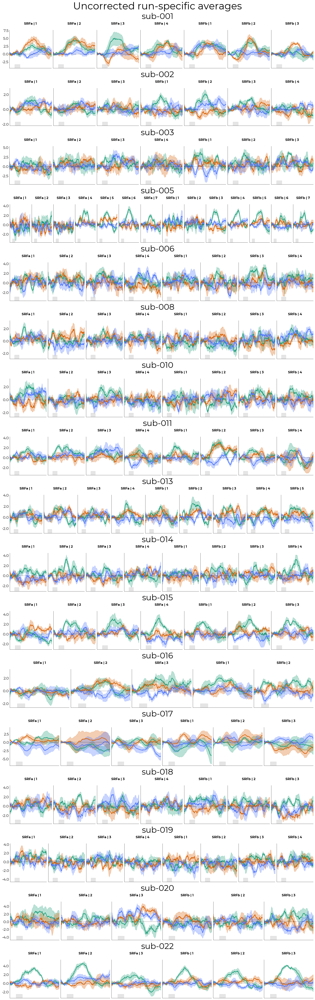

In [65]:
%matplotlib inline

subj_ids = utils.get_unique_ids(run_uncorr, id="subject")
excl_list = [
    # "001",
    # "003"
]
subj_ids = [i for i in subj_ids if i not in excl_list]

#----------------------------------------------------------------------------------------------------------------------------------
# Subplots

# subj_ids = ["018"]

ncols = 5
nrows = len(subj_ids)
fig = plt.figure(figsize=(16,nrows*3), constrained_layout=True,)
sfs = fig.subfigures(
    nrows=nrows,
)

try:
    sfs_flat = sfs.flatten()
except:
    sfs_flat = sfs

for ix,subj in enumerate(subj_ids):

    print(f"plotting sub-{subj}")
    if len(subj_ids) > 1:
        sf = sfs_flat[ix]
    else:
        sf = sfs_flat

    select_sub = utils.select_from_df(run_uncorr, expression=f"subject = {subj}")
    task_ids = utils.get_unique_ids(select_sub, id="task")
    
    runs = 0
    for task in task_ids:
        task_df = utils.select_from_df(select_sub, expression=f"task = {task}")
        n_runs = len(utils.get_unique_ids(task_df, id="run"))
        runs += n_runs
    
    axs = sf.subplots(ncols=runs, sharex=True, sharey=True)

    ct = 0
    for task in task_ids:
        task_df = utils.select_from_df(select_sub, expression=f"task = {task}")
        run_ids = utils.get_unique_ids(task_df, id="run")

        for run in run_ids:
            tmp_df = utils.select_from_df(task_df, expression=f"run = {run}")
            t_ = utils.get_unique_ids(tmp_df, id="t")
            sub_gm = utils.select_from_df(tmp_df, expression="ribbon", indices=[0])

            run_epoch = hr.viz.PlotEpochProfiles(
                sub_gm.groupby(["subject","event_type", "epoch","t"]).mean(),
                axs=axs[ct],
                ev_names=["center","near","far"],
                cm=subj_obj.get_colors(),
                bsl=20,
                x_ticks=[], #np.arange(t_[0],t_[-1]*1.1, step=2),
                x_ticklabels=[],
                y_dec=1,
                labels=None,
                y_label=None,
                x_label=None,
                title=f"{task} | {run}",
                force_title=True,
                title_size=12                
            )    

            ct += 1

    sf.suptitle(f"sub-{subj}", fontsize=30)

fig.suptitle("Uncorrected run-specific averages", fontsize=36)
hr.viz._save_figure(
    fig, 
    fname="run_epochs_uncorr", 
    overwrite=False
)

#### corrected

plotting sub-001
plotting sub-002
plotting sub-003
plotting sub-005
plotting sub-006
plotting sub-008
plotting sub-010
plotting sub-011
plotting sub-013
plotting sub-014
plotting sub-015
plotting sub-016
plotting sub-017
plotting sub-018
plotting sub-019
plotting sub-020
plotting sub-022
Writing '/data1/projects/MicroFunc/Jurjen/programs/project_repos/holeresponse/images/run_epochs_corr.pdf'
Writing '/data1/projects/MicroFunc/Jurjen/programs/project_repos/holeresponse/images/run_epochs_corr.png'
Writing '/data1/projects/MicroFunc/Jurjen/programs/project_repos/holeresponse/images/run_epochs_corr.svg'


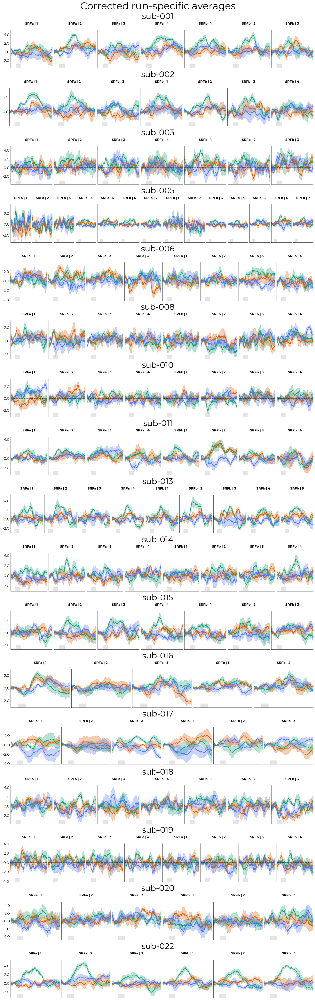

In [67]:
%matplotlib inline
subj_ids = utils.get_unique_ids(run_corr, id="subject")

subj = "sub-013"
excl_list = [
    # "001",
    # "003"
]
subj_ids = [i for i in subj_ids if i not in excl_list]

#----------------------------------------------------------------------------------------------------------------------------------
# Subplots

# subj_ids = ["018"]

ncols = 5
nrows = len(subj_ids)
fig = plt.figure(figsize=(16,nrows*3), constrained_layout=True,)
sfs = fig.subfigures(
    nrows=nrows,
)

try:
    sfs_flat = sfs.flatten()
except:
    sfs_flat = sfs

for ix,subj in enumerate(subj_ids):

    print(f"plotting sub-{subj}")
    if len(subj_ids) > 1:
        sf = sfs_flat[ix]
    else:
        sf = sfs_flat

    select_sub = utils.select_from_df(run_corr, expression=f"subject = {subj}")
    task_ids = utils.get_unique_ids(select_sub, id="task")
    
    runs = 0
    for task in task_ids:
        task_df = utils.select_from_df(select_sub, expression=f"task = {task}")
        n_runs = len(utils.get_unique_ids(task_df, id="run"))
        runs += n_runs
    
    axs = sf.subplots(ncols=runs, sharex=True, sharey=True)

    ct = 0
    for task in task_ids:
        task_df = utils.select_from_df(select_sub, expression=f"task = {task}")
        run_ids = utils.get_unique_ids(task_df, id="run")

        for run in run_ids:
            tmp_df = utils.select_from_df(task_df, expression=f"run = {run}")
            t_ = utils.get_unique_ids(tmp_df, id="t")
            sub_gm = utils.select_from_df(tmp_df, expression="ribbon", indices=[0])

            run_epoch = hr.viz.PlotEpochProfiles(
                sub_gm.groupby(["subject","event_type", "epoch","t"]).mean(),
                axs=axs[ct],
                ev_names=["center","near","far"],
                cm=subj_obj.get_colors(),
                bsl=20,
                x_ticks=[],
                x_ticklabels=[],
                y_dec=1,
                labels=None,
                y_label=None,
                x_label=None,
                title=f"{task} | {run}",
                force_title=True,
                title_size=12
            )    

            ct += 1

    sf.suptitle(f"sub-{subj}", fontsize=30)

fig.suptitle("Corrected run-specific averages", fontsize=36)
hr.viz._save_figure(
    fig, 
    fname="run_epochs_corr", 
    overwrite=False
)

#### merged

plotting sub-001
plotting sub-002
plotting sub-003
plotting sub-005
plotting sub-006
plotting sub-008
plotting sub-010
plotting sub-011
plotting sub-013
plotting sub-014
plotting sub-015
plotting sub-016
plotting sub-017
plotting sub-018
plotting sub-019
plotting sub-020
plotting sub-022


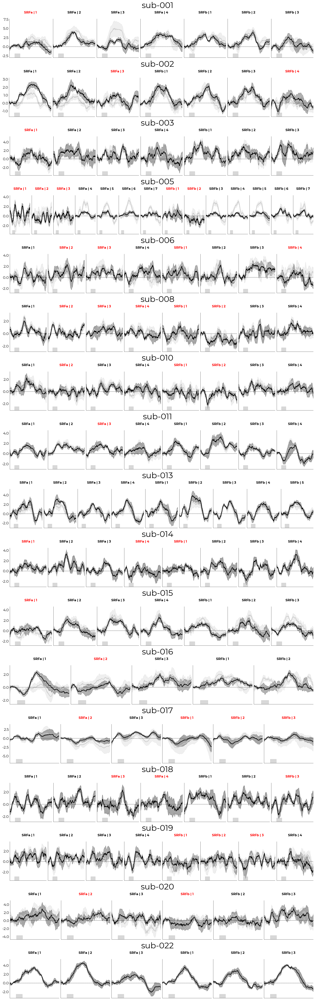

In [33]:
%matplotlib inline
subj_ids = utils.get_unique_ids(run_corr, id="subject")
# subj_ids = ["001"]


#----------------------------------------------------------------------------------------------------------------------------------
# Subplots

ncols = 5
nrows = len(subj_ids)
fig = plt.figure(figsize=(16,nrows*3), constrained_layout=True)
sfs = fig.subfigures(
    nrows=nrows,
)

try:
    sfs_flat = sfs.flatten()
except:
    sfs_flat = sfs

for ix,subj in enumerate(subj_ids):

    print(f"plotting sub-{subj}")
    if len(subj_ids) > 1:
        sf = sfs_flat[ix]
    else:
        sf = sfs_flat
    
    # this is just to get the correct task/run IDs
    select_sub = utils.select_from_df(run_corr, expression=f"subject = {subj}")
    task_ids = utils.get_unique_ids(select_sub, id="task")
    
    runs = 0
    for task in task_ids:
        task_df = utils.select_from_df(select_sub, expression=f"task = {task}")
        n_runs = len(utils.get_unique_ids(task_df, id="run"))
        runs += n_runs
    
    axs = sf.subplots(
        ncols=runs, 
        sharex=True, 
        sharey=True
    )

    ct = 0
    for task in task_ids:
        task_df = utils.select_from_df(select_sub, expression=f"task = {task}")
        run_ids = utils.get_unique_ids(task_df, id="run")

        excl_tasks = subj_obj.get_excl_runs(f"sub-{subj}", task)
        for run in run_ids:
            
            txt_col = "k"
            if int(run) in excl_tasks:
                txt_col = "r"

            for df_i,(df,color) in enumerate(zip([run_uncorr,run_corr],["#cccccc","k"])):

                # actual data used
                tmp_df = utils.multiselect_from_df(
                    df, 
                    expression=[
                        f"subject = {subj}",
                        f"task = {task}",
                        f"run = {run}",
                        f"event_type = act"
                    ]
                )
                
                t_ = utils.get_unique_ids(tmp_df, id="t")
                sub_gm = utils.select_from_df(tmp_df, expression="ribbon", indices=[0])

                title = None
                if df_i == 1:
                    title = {
                        "title": f"{task} | {run}",
                        "color": txt_col,
                        "fontweight": "bold"
                    }

                run_epoch = hr.viz.PlotEpochProfiles(
                    sub_gm.groupby(["subject","event_type", "epoch","t"]).mean(),
                    axs=axs[ct],
                    color=color,
                    bsl=20,
                    x_ticks=[],
                    x_ticklabels=[],
                    y_dec=1,
                    labels=None,
                    y_label=None,
                    x_label=None,
                    title=title,
                    force_title=True,
                    title_size=12
                )    

            ct += 1

    sf.suptitle(f"sub-{subj}", fontsize=30)

# hr.viz._save_figure(
#     fig, 
#     fname="run_epochs_merged", 
#     overwrite=False
# )

### Averaged over runs

#### Uncorrected

Plotting 001
Plotting 002
Plotting 003
Plotting 005
Plotting 006
Plotting 008
Plotting 010
Plotting 011
Plotting 013
Plotting 014
Plotting 015
Plotting 016
Plotting 017
Plotting 018
Plotting 019
Plotting 020
Plotting 022
Adding insets


Text(0.5, 0.01, 'time (s)')

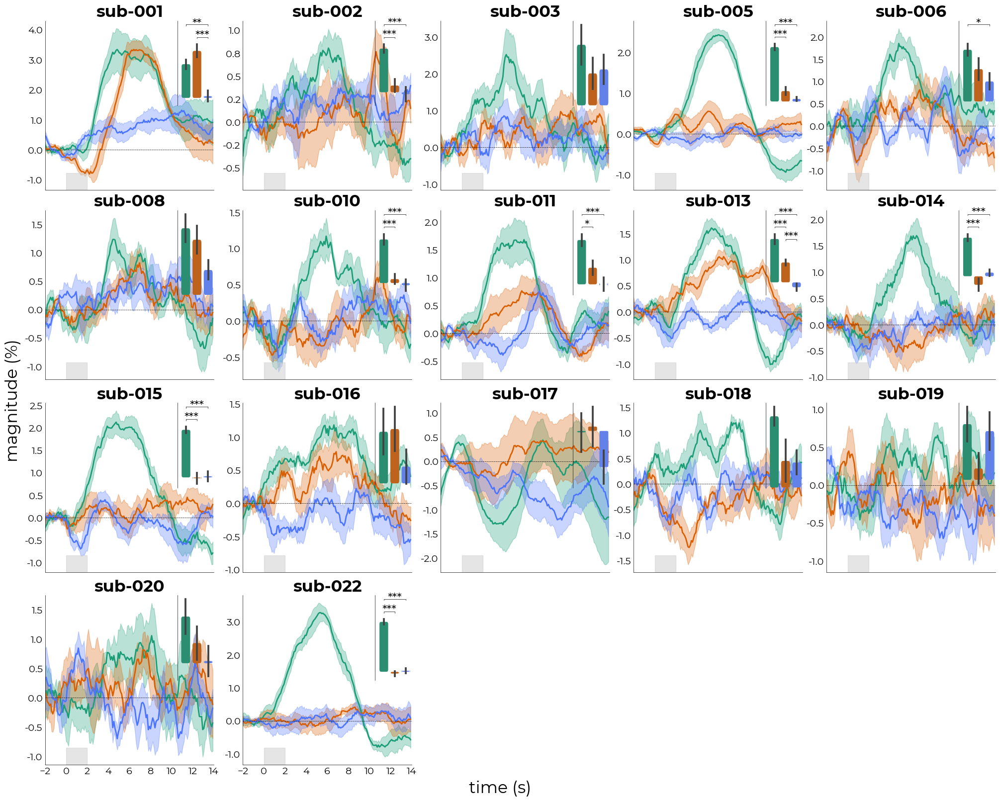

In [90]:
%matplotlib inline

import matplotlib.gridspec as gridspec
subj_ids = utils.get_unique_ids(sub_uncorr, id="subject")

subj = "sub-013"
excl_list = [
    # "001",
    # "003"
]
subj_ids = [i for i in subj_ids if i not in excl_list]

ncols = 5
nrows = int(np.ceil(len(subj_ids)/ncols))
fig,axs = plt.subplots(
    figsize=(ncols*4,nrows*4),
    ncols=ncols,
    nrows=nrows,
    constrained_layout=True,
    sharex=True
)

#----------------------------------------------------------------------------------------------------------------------------------
# Subplots

sub_ax = {}
for ix,ax in enumerate(axs.flatten()):

    if (ix+1)>len(subj_ids):
        # remove obsolete axes
        ax.remove()
    else:

        sub = subj_ids[ix]
        print(f"Plotting {sub}")
        # print(f"col_nr = {col_nr}; row_nr = {row_nr}")

        select_sub = utils.select_from_df(sub_uncorr, expression=f"subject = {sub}")
        t_ = utils.get_unique_ids(select_sub, id="t")
        sub_gm = utils.select_from_df(select_sub, expression="ribbon", indices=[0])
        avg_epoch = hr.viz.PlotEpochProfiles(
            sub_gm.groupby(["subject","event_type", "epoch","t"]).mean(),
            axs=ax,
            ev_names=["center","near","far"],
            cm=subj_obj.get_colors(),
            bsl=20,
            x_ticks=np.arange(t_[0],t_[-1]*1.1, step=2),
            y_dec=1,
            labels=None,
            y_label=None,
            x_label=None
        )
        
        # sub_name = f"sub-{str(ix+1).zfill(2)}"
        sub_name = f"sub-{sub}"
        ax.set_title(
            sub_name, 
            fontsize=24, 
            fontweight="bold"
        )

        sub_ax[sub] = ax.inset_axes([0.8,0.5,0.2,0.5])

# add barplots as insets
print("Adding insets")
sub_excl = []
for i in subj_ids:
    sub_excl.append(utils.select_from_df(sub_uncorr, expression=f"subject = {i}"))
sub_excl = pd.concat(sub_excl)

tm = hr.viz.MagnitudePerEvent(
    hr.data.melt_epochs(sub_excl), # use average of order-specific runs (usually 2 for each subj, so 2x5 averages = 10 points)
    # add_points=True,
    points_color="k",
    y_dec=1,
    palette=subj_obj.get_colors(),
    sns_offset=4,
    add_title=False,
    as_index=True,
    fancy=True,
    # posth=False,
    axs=sub_ax,
    ticks=[],
    posthoc_kws={
        "y_pos": 1.25,
        "line_separate_factor": -0.2,
        "ast_frac": -0.05
    }
)

fig.supylabel("magnitude (%)", fontsize=24)
fig.supxlabel("time (s)", fontsize=24)
# hr.viz._save_figure(
#     fig, 
#     fname="group_desc-epochs_subjects", 
#     overwrite=True
# )

#### Corrected

Plotting 001
Plotting 002
Plotting 003
Plotting 005
Plotting 006
Plotting 008
Plotting 010
Plotting 011
Plotting 013
Plotting 014
Plotting 015
Plotting 016
Plotting 017
Plotting 018
Plotting 019
Plotting 020
Plotting 022
Adding insets


Text(0.5, 0.01, 'time (s)')

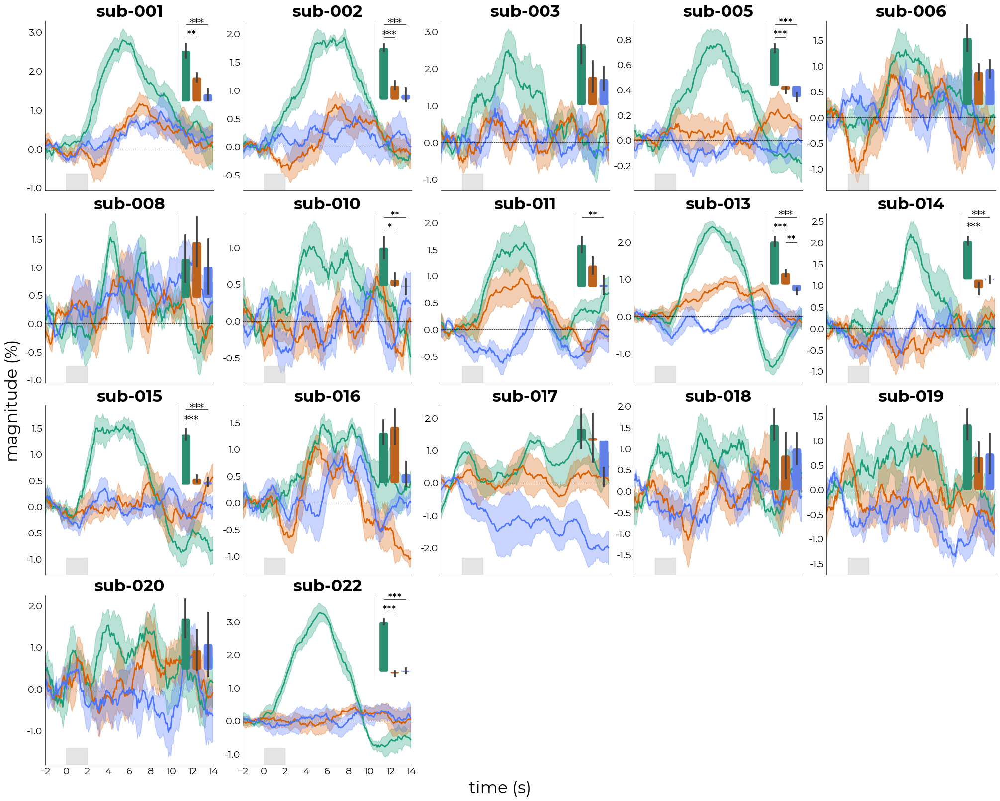

In [38]:
%matplotlib inline
subj_ids = utils.get_unique_ids(sub_corr, id="subject")
excl_list = [
    # "001",
    # "003"
]
subj_ids = [i for i in subj_ids if i not in excl_list]

ncols = 5
nrows = int(np.ceil(len(subj_ids)/ncols))
fig,axs = plt.subplots(
    figsize=(ncols*4,nrows*4),
    ncols=ncols,
    nrows=nrows,
    constrained_layout=True,
    sharex=True
)

#----------------------------------------------------------------------------------------------------------------------------------
# Subplots

sub_ax = {}
for ix,ax in enumerate(axs.flatten()):

    if (ix+1)>len(subj_ids):
        # remove obsolete axes
        ax.remove()
    else:

        sub = subj_ids[ix]
        print(f"Plotting {sub}")
        # print(f"col_nr = {col_nr}; row_nr = {row_nr}")

        select_sub = utils.select_from_df(sub_corr, expression=f"subject = {sub}")
        t_ = utils.get_unique_ids(select_sub, id="t")
        sub_gm = utils.select_from_df(select_sub, expression="ribbon", indices=[0])
        avg_epoch = hr.viz.PlotEpochProfiles(
            sub_gm.groupby(["subject","event_type", "epoch","t"]).mean(),
            axs=ax,
            ev_names=["center","near","far"],
            cm=subj_obj.get_colors(),
            bsl=20,
            x_ticks=np.arange(t_[0],t_[-1]*1.1, step=2),
            y_dec=1,
            labels=None,
            y_label=None,
            x_label=None
        )
        
        # sub_name = f"sub-{str(ix+1).zfill(2)}"
        sub_name = f"sub-{sub}"
        ax.set_title(
            sub_name, 
            fontsize=24, 
            fontweight="bold"
        )

        sub_ax[sub] = ax.inset_axes([0.8,0.5,0.2,0.5])

# add barplots as insets
print("Adding insets")
sub_excl = []
for i in subj_ids:
    sub_excl.append(utils.select_from_df(sub_corr, expression=f"subject = {i}"))
sub_excl = pd.concat(sub_excl)

tm = hr.viz.MagnitudePerEvent(
    hr.data.melt_epochs(sub_excl), # use average of order-specific runs (usually 2 for each subj, so 2x5 averages = 10 points)
    # add_points=True,
    points_color="k",
    y_dec=1,
    palette=subj_obj.get_colors(),
    sns_offset=4,
    add_title=False,
    as_index=True,
    fancy=True,
    # posth=False,
    axs=sub_ax,
    ticks=[],
    posthoc_kws={
        "y_pos": 1.25,
        "line_separate_factor": -0.2,
        "ast_frac": -0.05
    }
)

fig.supylabel("magnitude (%)", fontsize=24)
fig.supxlabel("time (s)", fontsize=24)
# hr.viz._save_figure(
#     fig, 
#     fname="group_desc-epochs_subjects", 
#     overwrite=True
# )

## Check draining vein effect for center response

### Before correction

In [383]:
comp_ep = fitting.Epoch(
    h5_obj.df_comps.groupby(["subject","task","t"]).mean(),
    hr.data.average_tasks(corr_obj.df_onsets),
    TR=0.105,
    interval=[-2,14]
)
comp_old = comp_ep.df_epoch.copy()
comp_old.head()

0         1         2  \
subject task run event_type epoch t                                         
001     SRFa 1   act        0     -2.000000  0.609978  0.954397  0.265559   
                                  -1.894737  0.504574  0.756675  0.252473   
                                  -1.789474  0.120399  0.296899 -0.056100   
                                  -1.684211  0.009483  0.119989 -0.101022   
                                  -1.578947 -0.037335  0.189199 -0.263869   

                                                    3         4         5  \
subject task run event_type epoch t                                         
001     SRFa 1   act        0     -2.000000 -0.423279 -0.911883 -1.333742   
                                  -1.894737 -0.251729 -0.741799 -1.227158   
                                  -1.789474 -0.409100 -0.812019 -1.231579   
                                  -1.684211 -0.322033 -0.661428 -1.040284   
                                  -1.578947 -0.716937 -0.976284 -1.171058   

                                                    6         7         8  \
subject task run event_type epoch t                                         
001     SRFa 1   act        0     -2.000000 -1.526677 -1.032837 -0.538998   
                                  -1.894737 -1.436565 -0.818118 -0.199671   
                                  -1.789474 -1.440138 -1.015695 -0.591253   
                                  -1.684211 -1.228798 -0.846289 -0.463780   
                                  -1.578947 -1.247471 -0.968800 -0.690128   

                                                    9        10        11  \
subject task run event_type epoch t                                         
001     SRFa 1   act        0     -2.000000 -0.570883 -0.778010 -1.071055   
                                  -1.894737 -0.344360 -0.743427 -1.247818   
                                  -1.789474 -0.711678 -1.013726 -1.414876   
                                  -1.684211 -0.541415 -0.772431 -1.084700   
                                  -1.578947 -0.511967 -0.367308 -0.440042   

                                                   12        13        14  \
subject task run event_type epoch t                                         
001     SRFa 1   act        0     -2.000000 -1.621856 -2.172657 -1.968612   
                                  -1.894737 -2.068182 -2.888545 -2.550078   
                                  -1.789474 -2.113329 -2.811782 -2.773292   
                                  -1.684211 -1.640727 -2.196754 -2.483239   
                                  -1.578947 -1.164952 -1.889861 -2.440260   

                                                   15        16        17  \
subject task run event_type epoch t                                         
001     SRFa 1   act        0     -2.000000 -1.512953 -1.120865 -0.919489   
                                  -1.894737 -1.825335 -1.252562 -1.135701   
                                  -1.789474 -2.489155 -2.203173 -1.911653   
                                  -1.684211 -2.679875 -2.779814 -2.589660   
                                  -1.578947 -2.932489 -3.200070 -2.793707   

                                                   18        19  
subject task run event_type epoch t                              
001     SRFa 1   act        0     -2.000000 -0.718113 -0.818801  
                                  -1.894737 -1.018839 -1.077270  
                                  -1.789474 -1.620134 -1.765894  
                                  -1.684211 -2.399506 -2.494583  
                                  -1.578947 -2.387344 -2.590526

plotting 001
plotting 002
plotting 003
plotting 005
plotting 006
plotting 008
plotting 010
plotting 011
plotting 013
plotting 014
plotting 015
plotting 016
plotting 017
plotting 018
plotting 019
plotting 020
plotting 022


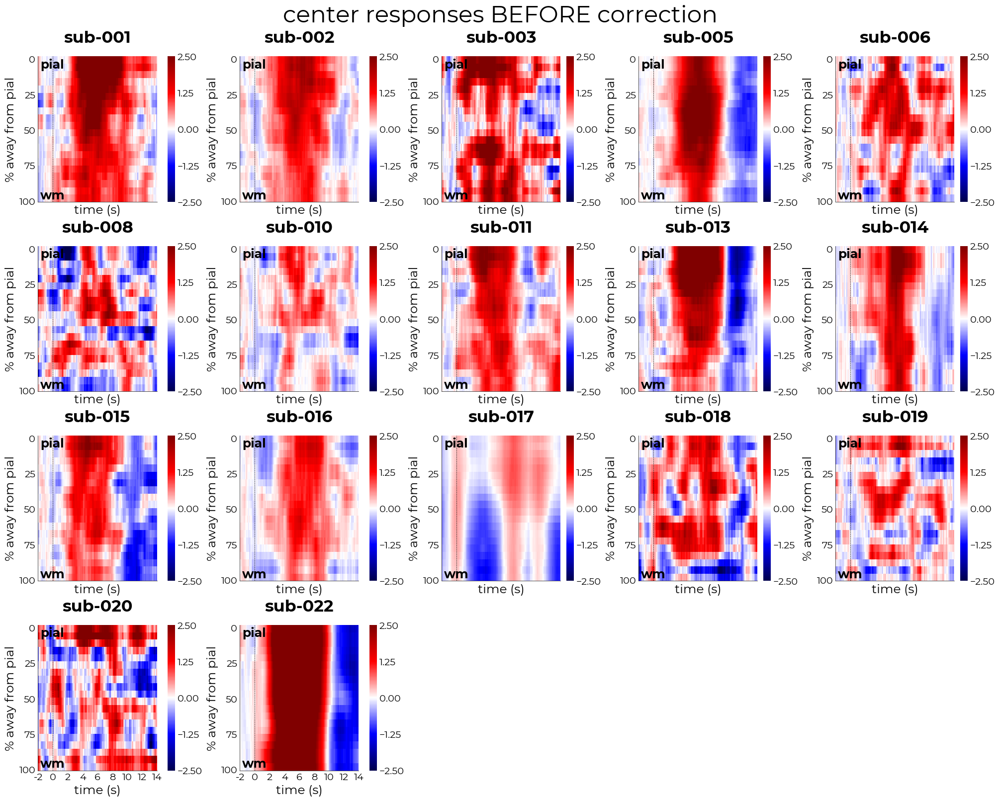

In [366]:

# fMRI 
in_data = comp_old.groupby(["subject","event_type","t"]).mean()
center_df = utils.select_from_df(in_data, expression="event_type = act")

%matplotlib inline
subj_ids = utils.get_unique_ids(in_data, id="subject")

subj = "013"
excl_list = [
    # "001",
    # "003"
]
subj_ids = [i for i in subj_ids if i not in excl_list]

ncols = 5
nrows = int(np.ceil(len(subj_ids)/ncols))
fig,axs = plt.subplots(
    figsize=(ncols*4,nrows*4),
    ncols=ncols,
    nrows=nrows,
    constrained_layout=True,
    sharex=True
)

for ix,ax in enumerate(axs.flatten()):

    if (ix+1)>len(subj_ids):
        # remove obsolete axes
        ax.remove()
    else:

        sub = subj_ids[ix]
        print(f"plotting {sub}")
        xy = hr.viz.XinYuPlot.single_xinyu_plot(
            utils.select_from_df(center_df, expression=f"subject = {sub}").groupby(["event_type","t"]).mean(),
            axs=ax,
            force_int=True,
            time_dec=0,
            time_ticks=9,
            depth_ticks=5,
            sns_kws={
                "vmin": -2.5,
                "vmax": 2.5
            },
            annot_color="k",
            contours=False,
            annot_onset=True,
            bsl=20,
            title={
                "title": f"sub-{sub}",
                "fontweight": "bold",
                "fontsize": 24
            }
        )

fig.suptitle("center responses BEFORE correction", fontsize=34)
hr.viz._save_figure(fig, fname="center_depth_uncorr") #, overwrite=True)

### After correction

In [39]:
comp_ep = fitting.Epoch(
    corr_obj.df_comps.groupby(["subject","task","t"]).mean(),
    hr.data.average_tasks(corr_obj.df_onsets),
    TR=0.105,
    interval=[-2,14]
)
comp_new = comp_ep.df_epoch.copy()
comp_new.head()

0         1         2  \
subject task run event_type epoch t                                         
001     SRFa 1   act        0     -2.000000  0.630385 -0.239497  1.500266   
                                  -1.894737  0.571895 -0.321802  1.465591   
                                  -1.789474 -0.009266 -1.035793  1.017260   
                                  -1.684211 -0.992481 -1.888901 -0.096061   
                                  -1.578947 -1.135379 -1.780816 -0.489943   

                                                    3         4         5  \
subject task run event_type epoch t                                         
001     SRFa 1   act        0     -2.000000  3.240028  2.311503  0.493548   
                                  -1.894737  3.252984  2.429860  0.736565   
                                  -1.789474  3.070313  2.421918  0.873040   
                                  -1.684211  1.696778  1.634299  0.953380   
                                  -1.578947  0.800929  0.760801  0.277005   

                                                    6         7         8  \
subject task run event_type epoch t                                         
001     SRFa 1   act        0     -2.000000 -0.636957  0.294886  1.226730   
                                  -1.894737 -0.339304  0.437110  1.213524   
                                  -1.789474 -0.095066  0.679145  1.453356   
                                  -1.684211  0.615390  1.306187  1.996985   
                                  -1.578947  0.188339  1.285059  2.381780   

                                                    9        10        11  \
subject task run event_type epoch t                                         
001     SRFa 1   act        0     -2.000000  0.187664 -1.508370 -2.492625   
                                  -1.894737  0.055865 -1.746485 -2.736501   
                                  -1.789474  0.286776 -1.526734 -2.603170   
                                  -1.684211  0.737841 -1.171282 -2.353904   
                                  -1.578947  1.129384 -0.906050 -2.245660   

                                                   12        13        14  \
subject task run event_type epoch t                                         
001     SRFa 1   act        0     -2.000000 -1.341541 -0.190457 -0.026837   
                                  -1.894737 -1.289514  0.157472  0.435645   
                                  -1.789474 -1.468380 -0.333591  0.092663   
                                  -1.684211 -1.357018 -0.360133 -0.049205   
                                  -1.578947 -1.497797 -0.749934 -0.415443   

                                                   15        16        17  \
subject task run event_type epoch t                                         
001     SRFa 1   act        0     -2.000000 -0.192371 -0.369028 -0.579055   
                                  -1.894737  0.324214  0.270976  0.392322   
                                  -1.789474  0.282739  0.469596  0.646800   
                                  -1.684211  0.033069  0.215174  0.696770   
                                  -1.578947 -0.218742  0.082698  0.698356   

                                                   18        19  
subject task run event_type epoch t                              
001     SRFa 1   act        0     -2.000000 -0.789081 -0.684068  
                                  -1.894737  0.513668  0.452995  
                                  -1.789474  0.824003  0.735401  
                                  -1.684211  1.178366  0.937568  
                                  -1.578947  1.314014  1.006185

plotting 001
plotting 002
plotting 003
plotting 005
plotting 006
plotting 008
plotting 010
plotting 011
plotting 013
plotting 014
plotting 015
plotting 016
plotting 017
plotting 018
plotting 019
plotting 020
plotting 022


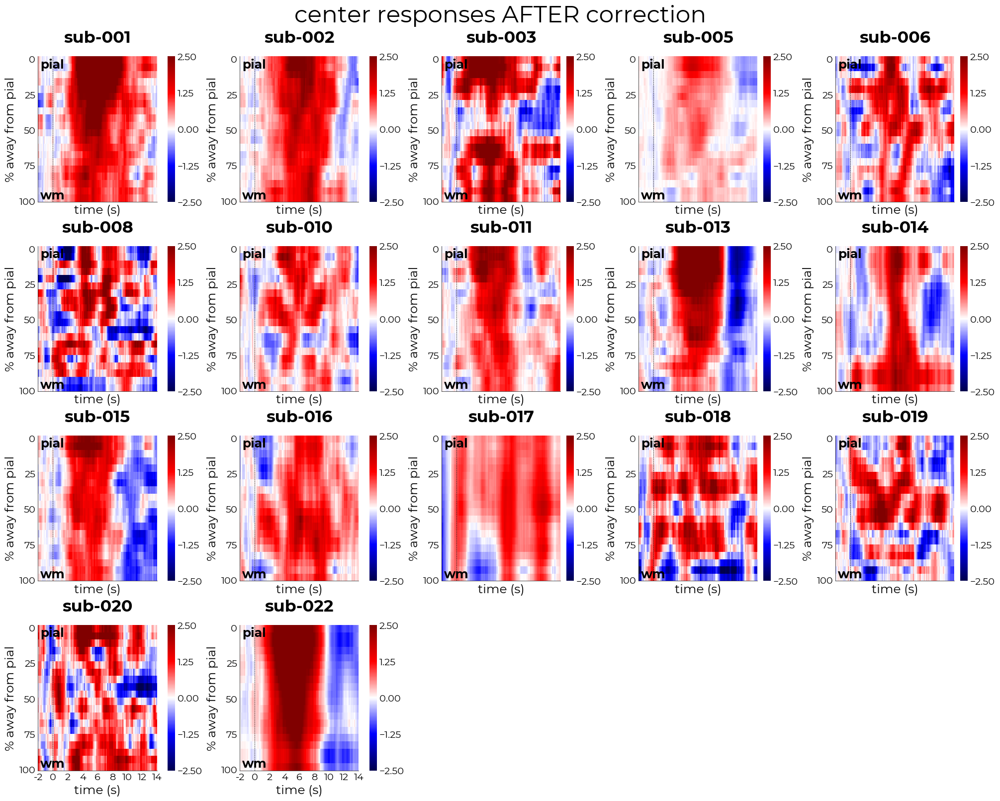

In [40]:

# fMRI 
in_data = comp_new.groupby(["subject","event_type","t"]).mean()
center_df = utils.select_from_df(in_data, expression="event_type = act")

%matplotlib inline
subj_ids = utils.get_unique_ids(in_data, id="subject")

subj = "013"
excl_list = [
    # "001",
    # "003"
]
subj_ids = [i for i in subj_ids if i not in excl_list]

ncols = 5
nrows = int(np.ceil(len(subj_ids)/ncols))
fig,axs = plt.subplots(
    figsize=(ncols*4,nrows*4),
    ncols=ncols,
    nrows=nrows,
    constrained_layout=True,
    sharex=True
)

for ix,ax in enumerate(axs.flatten()):

    if (ix+1)>len(subj_ids):
        # remove obsolete axes
        ax.remove()
    else:

        sub = subj_ids[ix]
        print(f"plotting {sub}")
        xy = hr.viz.XinYuPlot.single_xinyu_plot(
            utils.select_from_df(center_df, expression=f"subject = {sub}").groupby(["event_type","t"]).mean(),
            axs=ax,
            force_int=True,
            time_dec=0,
            time_ticks=9,
            depth_ticks=5,
            sns_kws={
                "vmin": -2.5,
                "vmax": 2.5
            },
            annot_color="k",
            contours=False,
            annot_onset=True,
            bsl=20,
            title={
                "title": f"sub-{sub}",
                "fontweight": "bold",
                "fontsize": 24
            }
        )

fig.suptitle("center responses AFTER correction", fontsize=34)
hr.viz._save_figure(fig, fname="center_depth_corr") #, overwrite=True)

### Check within timeframe

plotting 001
plotting 002
plotting 003
plotting 005
plotting 006
plotting 008
plotting 010
plotting 011
plotting 013
plotting 014
plotting 015
plotting 016
plotting 017
plotting 018
plotting 019
plotting 020
plotting 022


Text(0.5, 0.98, 'magnitude across depth between t=4 & t=7')

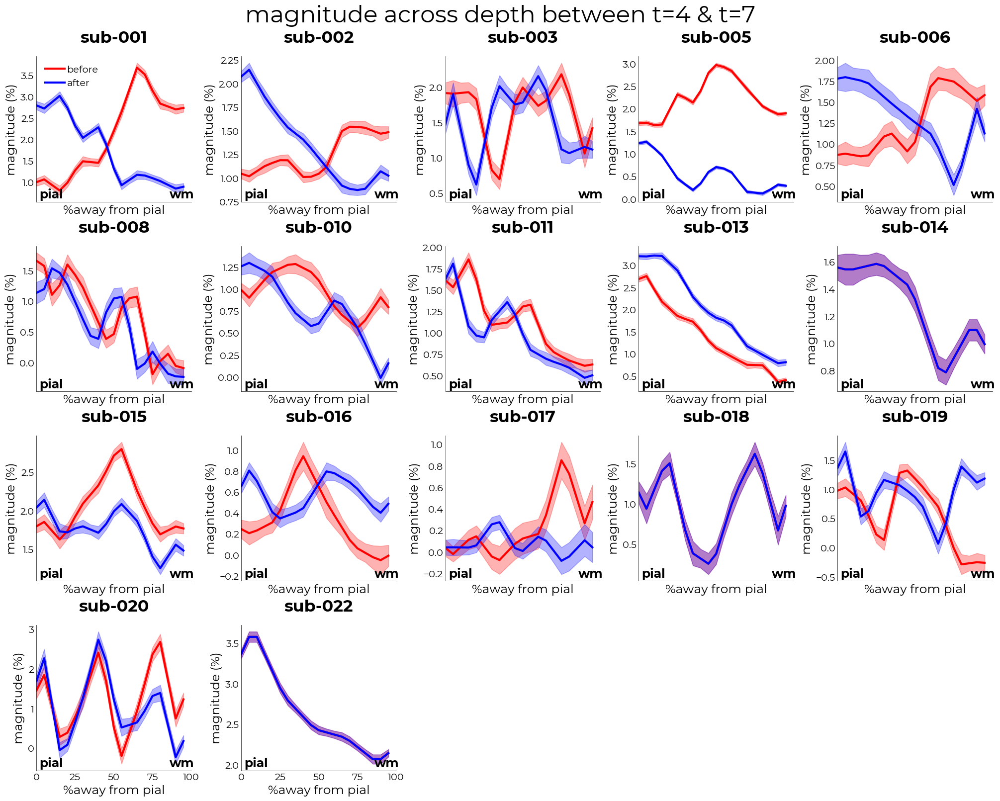

In [41]:
%matplotlib inline
subj_ids = utils.get_unique_ids(comp_new, id="subject")

excl_list = [
    # "001",
    # "003"
]
subj_ids = [i for i in subj_ids if i not in excl_list]

ncols = 5
nrows = int(np.ceil(len(subj_ids)/ncols))
fig,axs = plt.subplots(
    figsize=(ncols*4,nrows*4),
    ncols=ncols,
    nrows=nrows,
    constrained_layout=True,
    sharex=True
)

interval = [4,7]
for ix,ax in enumerate(axs.flatten()):

    if (ix+1)>len(subj_ids):
        # remove obsolete axes
        ax.remove()
    else:

        sub = subj_ids[ix]
        print(f"plotting {sub}")

        plot_data = []
        plot_err = []
        for df in [run_comps_uncorr, run_comps_corr]:

            ref_data = hr.data.make_single_df(
                utils.multiselect_from_df(
                    df, 
                    expression=[f"subject = {sub}", "event_type = act"]
                ), 
                idx=["subject", "run", "event_type", "epoch", "t"]
            )

            time_df = utils.select_from_df(
                ref_data, 
                expression=(
                    f"t > {interval[0]}",
                    "&",
                    f"t < {interval[1]}"
                )
            )

            grouper = time_df.groupby(["subject","event_type"])
            plot_data.append(grouper.mean().values.squeeze())
            plot_err.append(grouper.sem().values.squeeze())
        
        if ix == 0:
            lbls = ["before", "after"]
        else:
            lbls = None

        ddict = hr.viz.make_wm_pial_ticks(plot_data[0])
        pl = plotting.LazyPlot(
            plot_data,
            axs=ax,
            line_width=3,
            color=["r","b"],
            error=plot_err,
            x_ticks=ddict["ticks"],
            x_ticklabels=ddict["labels"],
            y_label="magnitude (%)",
            x_label="%away from pial",
            title={
                "title": f"sub-{sub}",
                "fontweight": "bold",
                "fontsize": 24
            },
            labels=lbls
        )

        hr.viz.annotate_cortical_ribbon(
            ax,
            pial_pos=(0.02,0.025),
            wm_pos=(0.86,0.025),
            fontsize=pl.font_size,
            fontweight="bold"
        )

fig.suptitle(f"magnitude across depth between t={interval[0]} & t={interval[1]}", fontsize=34)        

## Full QA Panel

plotting sub-001
plotting sub-002
plotting sub-003
plotting sub-005
plotting sub-006
plotting sub-008
plotting sub-010
plotting sub-011
plotting sub-013
plotting sub-014
plotting sub-015
plotting sub-016
plotting sub-017
plotting sub-018
plotting sub-019
plotting sub-020
plotting sub-022
Writing '/data1/projects/MicroFunc/Jurjen/programs/project_repos/holeresponse/images/qa_panel.pdf'
Writing '/data1/projects/MicroFunc/Jurjen/programs/project_repos/holeresponse/images/qa_panel.png'
Writing '/data1/projects/MicroFunc/Jurjen/programs/project_repos/holeresponse/images/qa_panel.svg'


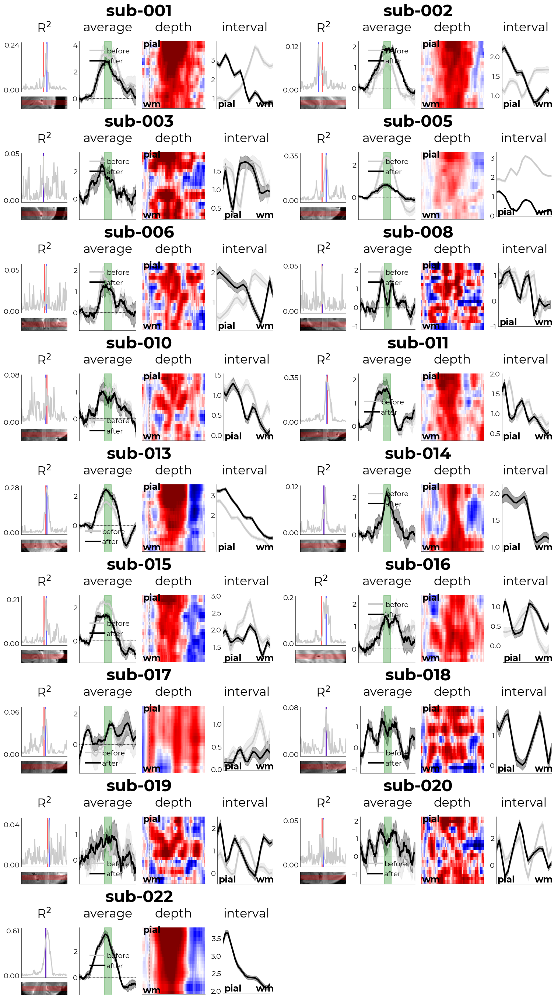

In [74]:
subjs = subj_obj.get_subjects()
# subjs = ["sub-001","sub-002"]
n_subjs = len(subjs)
ncols = 2
nrows = int(np.ceil(n_subjs/ncols))

fig = plt.figure(figsize=(15,nrows*3), constrained_layout=True)
sfs = fig.subfigures(
    ncols=ncols,
    nrows=nrows
)

if len(subjs)<1:
    sfs = [sfs]

center_df = utils.select_from_df(comp_new.groupby(["subject","event_type","t"]).mean(), expression=f"event_type = act")
for iix,(sub,sf) in enumerate(zip(subjs,sfs.flatten())):

    print(f"plotting {sub}")

    s_sf = sf.subfigures(ncols=4)

    # plot r2 over line + peaks
    pl1 = hr.viz.plot_r2_glm(
        sub,
        sub_glms,
        axs=s_sf[0],
        settings={"proj_dir": subj_obj.proj_dir},
        title="R$^2$",
        y_label=None,
        plot_kws={
            "x_ticks": [],
            "y_ticks": []
        }
    )
    
    # plot responses to center stimulus before/after correction
    interval = [5,7]
    pl = hr.viz.plot_single_response(
        [sub_uncorr,sub_corr],
        sub.split("-")[-1],
        axs=s_sf[1],
        color=["#cccccc","k"],
        labels=["before","after"],
        title="average",
        add_hline=0
    )

    pl.axvspan(*interval, color="g", alpha=0.3)

    # time x depth plot
    xy = hr.viz.XinYuPlot.single_xinyu_plot(
        utils.select_from_df(center_df, expression=f"subject = {sub.split('-')[-1]}").groupby(["event_type","t"]).mean(),
        axs=s_sf[2],
        sns_kws={
            "vmin": -2.5,
            "vmax": 2.5,
            "cbar": False
        },
        annot_color="k",
        contours=False,
        annot_onset=True,
        bsl=20,
        title="depth",
        y_lbl=None,
        x_lbl="",
        x_ticks=[],
        y_ticks=[]
    )

    pl2 = hr.viz.plot_draining_vein(
        [run_comps_uncorr,run_comps_corr],
        sub.split("-")[-1],
        axs=s_sf[3],
        title="interval",
        color=["#cccccc","k"]
    )

    sf.suptitle(sub, fontsize=32, fontweight="bold")

hr.viz._save_figure(
    fig, 
    fname="qa_panel", 
    overwrite=True
)

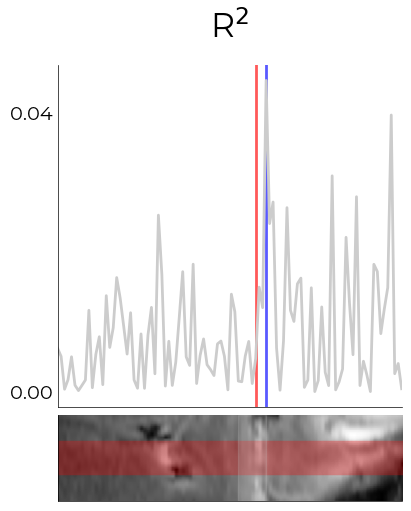

In [59]:
    pl1 = hr.viz.plot_r2_glm(
        "sub-019",
        sub_glms,
        # axs=s_sf[0],
        settings={"proj_dir": subj_obj.proj_dir},
        title="R$^2$",
        y_label=None,
        plot_kws={
            "x_ticks": [],
            "y_ticks": []
        }
    )

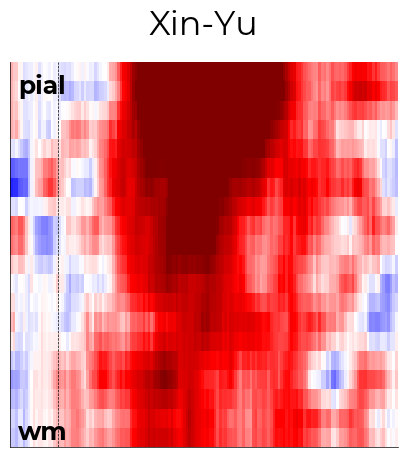

In [166]:
xy = hr.viz.XinYuPlot.single_xinyu_plot(
    utils.select_from_df(center_df, expression=f"subject = {sub.split('-')[-1]}").groupby(["event_type","t"]).mean(),
    # axs=s_sf[2],
    sns_kws={
        "vmin": -2.5,
        "vmax": 2.5,
        "cbar": False
    },
    annot_color="k",
    contours=False,
    annot_onset=True,
    bsl=20,
    title="Xin-Yu",
    y_lbl=None,
    x_lbl="",
    x_ticks=[],
    y_ticks=[]
)